# Figures and statistical calculation 
**Coder:** Nadia Sae-Lim <br>
**Date:** &nbsp; 2024-11-22 <br>
**Goals:** 1) Plot figures for the publication  <br>
&ensp; &ensp; &ensp; &ensp; 2) Calculate RMSE and Bias

In [2]:
# Initialization
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
from matplotlib.dates import MonthLocator, DateFormatter
from matplotlib.colors import ListedColormap
from matplotlib import colors
import cmaps
import matplotlib.cbook as cbook
import matplotlib.dates as mdates

## Figure 2: Climatological distribution.

In [ ]:
# Import inputs
df = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Final_inputs\ERA5_Land_1981-2023.csv")
df['datetime'] = pd.to_datetime(df['datetime'], format='%m/%d/%Y %H:%M') 
obs = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Observed-data\obs_Sibi_weather_perutime.csv") 
obs['datetime'] = pd.to_datetime(obs['datetime'], format='%m/%d/%Y %H:%M') 
obs2 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\CERES\CERES_west_grid_localtime.csv")   
obs2['datetime'] = pd.to_datetime(obs2['datetime'], format='%m/%d/%Y %H:%M') 

merged1 = pd.merge(df,obs,how='inner',left_on='datetime', right_on='datetime')   
merged2 = pd.merge(df, obs2, how = "inner", left_on='datetime', right_on='datetime')

In [ ]:
# Drop columns
merged1 = merged1.drop(columns=['datetime','Unnamed: 0'])
merged2 = merged2.drop(columns=['datetime','Unnamed: 0','Date'])

In [ ]:
# Calculate Hourly and Monthly means
hour1 = merged1.groupby(["Hour_x"]).mean()
hour1_std = merged1.groupby(["Hour_x"]).std()
hour2 = merged2.groupby(["Hour_x"]).mean()
hour2_std = merged2.groupby(["Hour_x"]).std()

month1 = merged1.groupby(["Month"], as_index=False).mean()
month1_std = merged1.groupby(["Year","Month"], as_index=False).mean().groupby(["Month"], as_index=False).std()
month2 = merged2.groupby(["Month_y"], as_index=False).mean()
month2_std = merged2.groupby(["Year_x","Month_x"], as_index=False).mean().iloc[1:,:].groupby(["Month_x"], as_index=False).std()

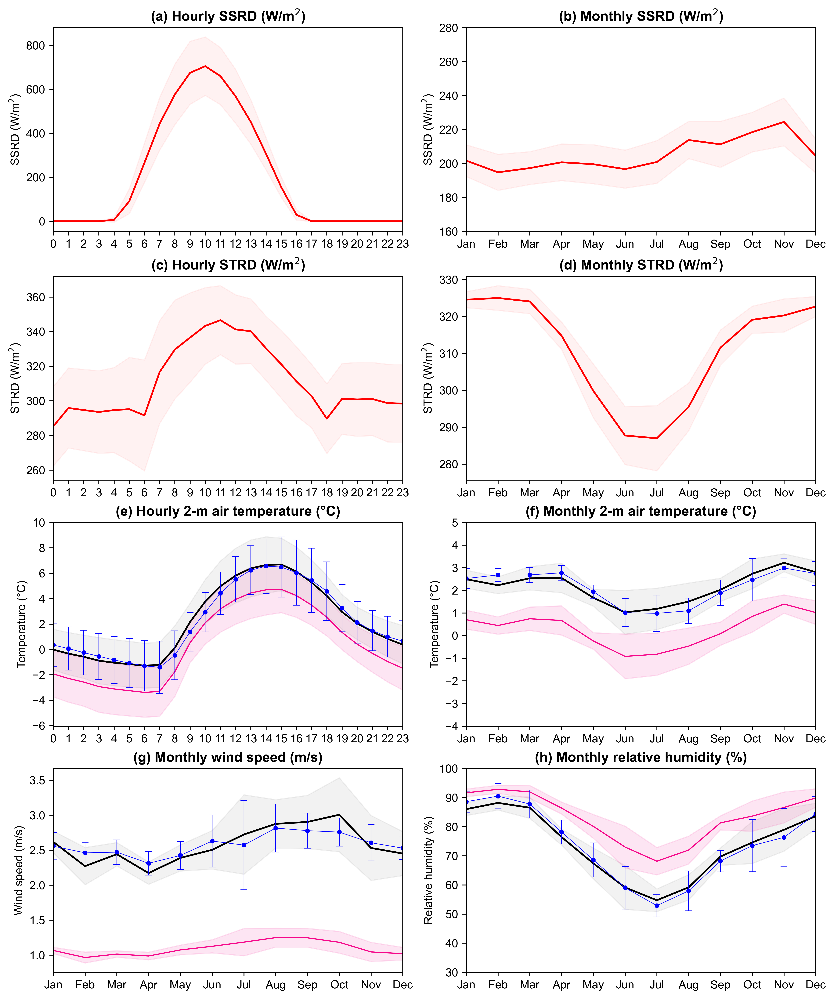

In [11]:
# Figure 2
fig = plt.figure(figsize=(10, 12), layout="constrained", dpi = 600)
plt.rcParams.update({'font.size': 10})
plt.rcParams["font.family"] = "Arial"
spec = fig.add_gridspec(4, 2) # 4 rows, 2 columns

#############################################
# Row 1
ax00 = fig.add_subplot(spec[0, 0]) # hourly ssrd
ax01 = fig.add_subplot(spec[0, 1]) # monthly ssrd

# Row 2
ax10 = fig.add_subplot(spec[1, 0]) # hourly strd
ax11 = fig.add_subplot(spec[1, 1]) # monthly strd

# Row 3
ax20 = fig.add_subplot(spec[2, 0]) # hourly t2m
ax21 = fig.add_subplot(spec[2, 1]) # monthlt t2m

# Row 4
ax30 = fig.add_subplot(spec[3, 0]) # monthly wind
ax31 = fig.add_subplot(spec[3, 1]) # d2m

#############################################
str_month_list = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']
#############################################

# panel (a)
ax00.fill_between(hour2.Hour_y, hour2.ssrd_y-hour2_std.ssrd_y,hour2.ssrd_y+hour2_std.ssrd_y, color = "r", alpha = 0.05)
ax00.plot(hour2.Hour_y, hour2.ssrd_y,"-",color = "r", linewidth = 1.5) 
ax00.set_xlim(0,23)
ax00.set_xticks(range(0,24,1))
ax00.set_title("(a) Hourly SSRD (W/m$^{2}$)",fontweight='bold')
ax00.set_ylabel("SSRD (W/m$^{2}$)")


# panel (b)
ax01.fill_between(month2.Month_x, month2.ssrd_y - month2_std.ssrd_y,month2.ssrd_y + month2_std.ssrd_y,color = "r", alpha = 0.05)
ax01.plot(month2.Month_x, month2.ssrd_y, color = "r", linewidth = 1.5)
ax01.set_xlim(1,12)
ax01.set_xticks(range(1,13,1))
ax01.set_xticklabels(str_month_list)
ax01.set_title("(b) Monthly SSRD (W/m$^{2}$)",fontweight='bold')
ax01.set_ylabel("SSRD (W/m$^{2}$)")
ax01.set_yticks(range(160,290,20))

# panel (c)
ax10.fill_between(hour2.Hour_y, hour2.strd_y-hour2_std.strd_y,hour2.strd_y+hour2_std.strd_y, color = "r", alpha = 0.05)
ax10.plot(hour2.Hour_y, hour2.strd_y,"-",color = "r", linewidth = 1.5) # Qm-ERA5
ax10.set_xlim(0,23)
ax10.set_xticks(range(0,24,1))
ax10.set_title("(c) Hourly STRD (W/m$^{2}$)",fontweight='bold')
ax10.set_ylabel("STRD (W/m$^{2}$)")

# panel (d)
ax11.fill_between(month2.Month_x, month2.strd_y - month2_std.strd_y,month2.strd_y + month2_std.strd_y,color = "r", alpha = 0.05)
ax11.plot(month2.Month_x, month2.strd_y, color = "r", linewidth = 1.5)
ax11.set_xlim(1,12)
ax11.set_xticks(range(1,13,1))
ax11.set_xticklabels(str_month_list)
ax11.set_title("(d) Monthly STRD (W/m$^{2}$)",fontweight='bold')
ax11.set_ylabel("STRD (W/m$^{2}$)")


# panel (e)
ax20.plot(hour1.Hour_y, hour1.t2m_qm - 273.15,"-",color = "k", linewidth = 1.5) # Qm-ERA5
ax20.fill_between(hour1.Hour_y,hour1.t2m_qm - hour1_std.t2m_qm- 273.15,hour1.t2m_qm + hour1_std.t2m_qm- 273.15, color = "k", alpha = 0.05)
ax20.plot(hour1.Hour_y, hour1.t2m- 273.15, "-", color = "#f5078a", linewidth = 1) # ERA5-Land
ax20.fill_between(hour1.Hour_y, hour1.t2m - hour1_std.t2m- 273.15, hour1.t2m + hour1_std.t2m- 273.15, color = "#f5078a", alpha = 0.1)
ax20.errorbar(hour1.Hour_y, hour1.Temp, hour1_std.Temp, color='b', ls='-', marker='.', capsize=3, capthick=0.5, ecolor='b', linewidth = 0.5) # Observation
ax20.set_xlim(0,23)
ax20.set_xticks(range(0,24,1))
ax20.set_title("(e) Hourly 2-m air temperature (\u00B0C)",fontweight='bold')
ax20.set_ylabel("Temperature (\u00B0C)")
ax20.set_yticks(range(-6,11,2))

# panel (f)
ax21.plot(month1.Month, month1.t2m_qm - 273.15,"-",color = "k", linewidth = 1.5) # Qm-ERA5
ax21.fill_between(month1.Month,month1.t2m_qm - month1_std.t2m_qm- 273.15,month1.t2m_qm + month1_std.t2m_qm- 273.15, color = "k", alpha = 0.05)
ax21.plot(month1.Month, month1.t2m- 273.15, "-", color = "#f5078a", linewidth = 1) # ERA5-Land
ax21.fill_between(month1.Month, month1.t2m - month1_std.t2m- 273.15, month1.t2m + month1_std.t2m- 273.15, color = "#f5078a", alpha = 0.1)
ax21.errorbar(month1.Month, month1.Temp, month1_std.Temp, color='b', ls='-', marker='.', capsize=3, capthick=0.5, ecolor='b', linewidth = 0.5) # Observation
ax21.set_xlim(1,12)
ax21.set_xticks(range(1,13,1))
ax21.set_xticklabels(str_month_list)
ax21.set_title("(f) Monthly 2-m air temperature (\u00B0C)",fontweight='bold')
ax21.set_ylabel("Temperature (\u00B0C)")
ax21.set_yticks(range(-4,6,1))

# panel (g)
ax30.plot(month1.Month, month1.wind_qm,"-",color = "k", linewidth = 1.5) # Qm-ERA5
ax30.fill_between(month1.Month,month1.wind_qm- month1_std.wind_qm,month1.wind_qm + month1_std.wind_qm, color = "k", alpha = 0.05)
ax30.plot(month1.Month, month1.wind, "-", color = "#f5078a", linewidth = 1) # ERA5-Land
ax30.fill_between(month1.Month, month1.wind - month1_std.wind, month1.wind + month1_std.wind, color = "#f5078a", alpha = 0.1)
ax30.errorbar(month1.Month, month1.wind_obs, month1_std.wind_obs, color='b', ls='-', marker='.', capsize=3, capthick=0.5, ecolor='b', linewidth = 0.5) # Observation
ax30.set_xlim(1,12)
ax30.set_xticks(range(1,13,1))
ax30.set_xticklabels(str_month_list)
ax30.set_title("(g) Monthly wind speed (m/s)",fontweight='bold')
ax30.set_ylabel("Wind speed (m/s)")

# panel (h)
ax31.plot(month1.Month, month1.RH_qm,"-",color = "k", linewidth = 1.5) # Qm-ERA5
ax31.fill_between(month1.Month,month1.RH_qm- month1_std.RH_qm,month1.RH_qm + month1_std.RH_qm, color = "k", alpha = 0.05)
ax31.plot(month1.Month, month1.RH_x, "-", color = "#f5078a", linewidth = 1) # ERA5-Land
ax31.fill_between(month1.Month, month1.RH_x - month1_std.RH_x, month1.RH_x + month1_std.RH_x, color = "#f5078a", alpha = 0.1)
ax31.errorbar(month1.Month, month1.RH_y, month1_std.RH_y, color='b', ls='-', marker='.', capsize=3, capthick=0.5, ecolor='b', linewidth = 0.5) # Observation
ax31.set_xlim(1,12)
ax31.set_xticks(range(1,13,1))
ax31.set_xticklabels(str_month_list)
ax31.set_title("(h) Monthly relative humidity (%)",fontweight='bold')
ax31.set_ylabel("Relative humidity (%)")
ax31.set_ylim(30,100)
ax31.set_yticks(range(30,105,10))

#fig.savefig("Figure2-onlyceres.jpg")

## Figure 3: Calibration results

In [ ]:
# Set up for the figure
from matplotlib.dates import MonthLocator, DateFormatter
month_fmt = DateFormatter('%b')
def m_fmt(x, pos=None):
    return month_fmt(x)[0]

In [12]:
# Import CDRN and ETA parameter file (which values were randomly generated.)
params = pd.read_csv(r'C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\lake-params.txt', delim_whitespace=True, header=None) 
params['cdrn'] = 2.5e-3*params[0] + 0.5e-3  #  neutral drag coefficient from 5 e-4 to 3 e-3
params['eta'] = 0.49*params[1] + 0.01       # shortwave extinction coefficient from 0.1 to 0.5
trials = range(1,101)
params['trial']=trials
params.head(5)

C:\Users\nadia\AppData\Local\Temp\ipykernel_50224\3285205936.py:2: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  params = pd.read_csv(r'C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\lake-params.txt', delim_whitespace=True, header=None)


,0,1,cdrn,eta,trial
0,0.246322,0.756449,0.001116,0.380660,1
1,0.238545,0.681547,0.001096,0.343958,2
2,0.174799,0.974795,0.000937,0.487649,3
3,0.731461,0.092749,0.002329,0.055447,4
4,0.040776,0.726045,0.000602,0.365762,5


#### The distribution of ERA and CDRN

In [ ]:
plt.scatter(params.eta,params.cdrn)

In [ ]:
# Set x-axis
t = pd.date_range(start='2016-01-01', end='2018-12-31')
t2 = pd.date_range(start='2016-08-30', end='2018-08-11')
t3 = pd.date_range(start = '2017-08-21', end = "2018-08-07")

In [ ]:
# Import lake temperature observations
sibi_obs = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Observed-data\SIB_south_2016-2018_r2.csv").iloc[:,1:]
sibi_obs_daily = sibi_obs.groupby(["Year","Month","Day"], as_index=False).mean()
sibi_obs_daily_std = sibi_obs.groupby(["Year","Month","Day"], as_index=False).std()
sibi_obs_n = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Observed-data\SIB_north_2017-2018_r.csv").iloc[:,1:]
sibi_obs_n_daily = sibi_obs_n.groupby(["Year","Month","Day"], as_index=False).mean()
sibi_obs_n_daily_std = sibi_obs_n.groupby(["Year","Month","Day"], as_index=False).std()
sibi_obs_n

In [ ]:
# Import all simulated files
import os
import glob
import sys
LST = [LST1,LST5,LST10,LST50,LST100,LST250,LST500,LST1000]
T22m = [T22m1, T22m5, T22m10, T22m50, T22m100, T22m250, T22m500, T22m1000]
num = [1,5,10,50,100,250,500,1000]

# series
path = "C:/Users/nadia/PhD/lakemodeling/Updated_analysis/Calibration/"
for j in range(0,len(num)):
      pathall = path + f'/mixfact{num[j]}'
      all_files = glob.glob(os.path.join(pathall,"profile-*.txt"))
        
      mixfact = (pd.read_csv(f, usecols = range(3,4), header = None, sep='\s+')
                   for f in all_files)
      LST[j] = pd.concat(mixfact, axis =1, ignore_index = True)

      mixfact = (pd.read_csv(f, usecols = range(25,26), header = None, sep='\s+')
                   for f in all_files)
      T22m[j] = pd.concat(mixfact, axis =1, ignore_index = True)

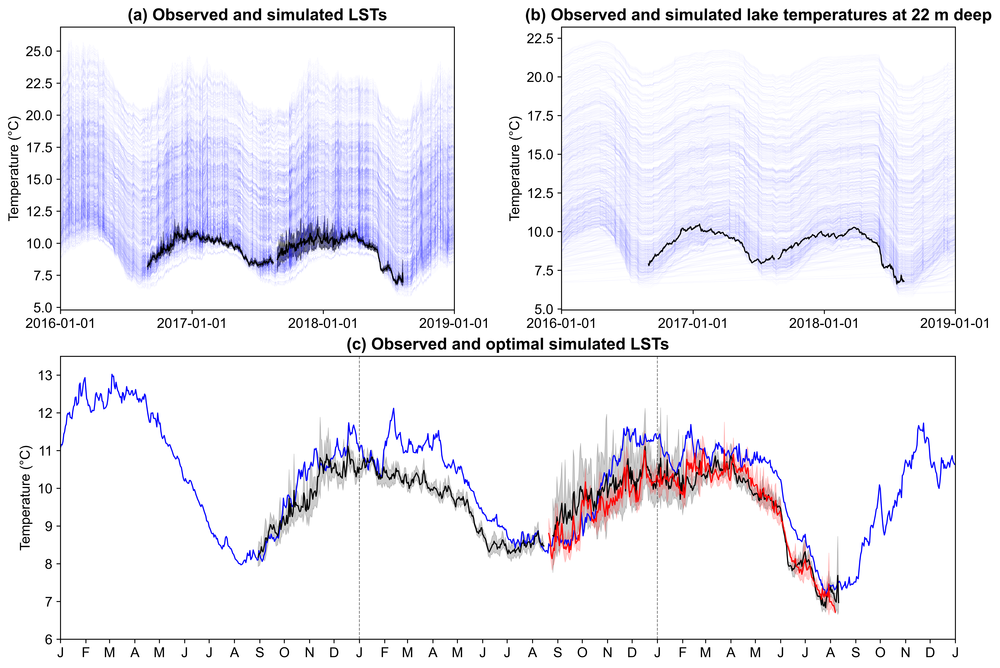

In [580]:
# Figure 3
fig = plt.figure(figsize=(12, 8), layout="constrained", dpi = 600)
plt.rcParams.update({'font.size': 12})
plt.rcParams["font.family"] = "Arial"
spec = fig.add_gridspec(2, 2) # 2 rows, 2 columns

#############################################
# Row 1
ax00 = fig.add_subplot(spec[0, 0]) # all LSTs
ax01 = fig.add_subplot(spec[0, 1]) # all 22m deep temps

# Row 2
ax10 = fig.add_subplot(spec[1, :]) # LST-air comparison
#############################################

ax00.set_title("(a) Observed and simulated LSTs", fontweight = "bold")
ax00.set_ylabel("Temperature (\u00B0C)")

for j in range(0,len(num)):
    ax00.plot(t,LST[j], linewidth = 0.1, color = "b", alpha = 0.1)
    
ax00.fill_between(t2,sibi_obs_daily.iloc[:,3] - sibi_obs_daily_std.iloc[:,3],sibi_obs_daily.iloc[:,3] + sibi_obs_daily_std.iloc[:,3],
                  alpha = 0.5, color = "k", linewidth = 0.5)
ax00.plot(t2,sibi_obs_daily.iloc[:,3], linewidth = 1, color = "k")
ax00.set_xlim([datetime.date(2016, 1, 1), datetime.date(2019, 1, 1)])
ax00.set_xticks([datetime.date(2016, 1, 1),datetime.date(2017, 1, 1),datetime.date(2018, 1, 1),datetime.date(2019, 1, 1)])
#ax00.xaxis.set_major_locator(MonthLocator())
#ax00.xaxis.set_major_formatter(FuncFormatter(m_fmt))

###############################################
for j in range(0,len(num)):
        ax01.plot(t,T22m[j], linewidth = 0.1, color = "b", alpha = 0.1)
    
ax01.plot(t2,sibi_obs_daily.iloc[:,12], linewidth = 1, color = "k")
ax01.fill_between(t2,sibi_obs_daily.iloc[:,12] - sibi_obs_daily_std.iloc[:,12],sibi_obs_daily.iloc[:,12] + sibi_obs_daily_std.iloc[:,12],
                  alpha = 0.5, color = "k", linewidth = 0.5)
ax01.set_xlim(16801,16801+366+365+365)
ax01.set_title("(b) Observed and simulated lake temperatures at 22 m deep", fontweight = "bold")
ax01.set_ylabel("Temperature (\u00B0C)")
ax01.set_xlim([datetime.date(2016, 1, 1), datetime.date(2019, 1, 1)])
ax01.set_xticks([datetime.date(2016, 1, 1),datetime.date(2017, 1, 1),datetime.date(2018, 1, 1),datetime.date(2019, 1, 1)])
#ax01.xaxis.set_major_locator(MonthLocator())
#ax01.xaxis.set_major_formatter(FuncFormatter(m_fmt))

###############################################

ax10.set_title("(c) Observed and optimal simulated LSTs", fontweight = "bold")
ax10.set_ylabel("Temperature (\u00B0C)")

ax10.plot(t,LST50.iloc[:,32], linewidth = 1, color = "b") #32
ax10.fill_between(t2,sibi_obs_daily.iloc[:,3] - sibi_obs_daily_std.iloc[:,3],sibi_obs_daily.iloc[:,3] + sibi_obs_daily_std.iloc[:,3],
                  alpha = 0.2, color = "k", linewidth = 0.5)
ax10.plot(t2,sibi_obs_daily.iloc[:,3], linewidth = 1, color = "k")
ax10.vlines(datetime.date(2017, 1, 1),6,14, linestyle = "--", linewidth = 0.7, alpha = 0.5, color = "k")
ax10.vlines(datetime.date(2018, 1, 1),6,14, linestyle = "--", linewidth = 0.7, alpha = 0.5, color = "k")
ax10.set_ylim(6,13.5)

ax10.fill_between(t3,sibi_obs_n_daily.iloc[:,3] - sibi_obs_n_daily_std.iloc[:,3],sibi_obs_n_daily.iloc[:,3] + sibi_obs_n_daily_std.iloc[:,3],
                  alpha = 0.2, color = "r", linewidth = 0.5)
ax10.plot(t3,sibi_obs_n_daily.iloc[:,3], linewidth = 1, color = "r")
ax10.set_xlim([datetime.date(2016, 1, 1), datetime.date(2019, 1, 1)])
#locator = mdates.MonthLocator()
#fmt = mdates.DateFormatter('%b')
ax10.xaxis.set_major_locator(MonthLocator())
ax10.xaxis.set_major_formatter(FuncFormatter(m_fmt))

#fig.savefig("Figure3_mixfact50_38.jpg")

## RMSE and Bias calculation

In [17]:
# Define RMSE and Bias
def rmse(predictions, targets):
    return np.sqrt((((predictions - targets)**2).sum())/len(targets))
def bias(predictions, targets): 
    return (targets.mean() - predictions.mean())

In [ ]:
# Import lake temperature observation (south end)
obs4 = sibi_obs_daily.iloc[:,3:]
obs4.columns = [0,1,2,3,4,5,6,7,8,9] # rename the columns (depth)
obs4

In [21]:
# RMSE calculation using the optimally simulated temperature from the original submission 
model = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\profile-505_final_nspin5.csv", skiprows = 12784+242, skipfooter =  365+(365-223),header = None)
model = model.iloc[:,[4,6,8,10,14,15,18,20,24,26]] # Select depths 
model.columns = [0,1,2,3,4,5,6,7,8,9] # rename columns
model

a = rmse(obs4, model).mean() # calculate mean RMSE across all depths
print(f"The original submission has RMSE of {round(a,3)}")

The original submission has RMSE of 0.761


C:\Users\nadia\AppData\Local\Temp\ipykernel_50224\3411562048.py:2: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support skipfooter; you can avoid this warning by specifying engine='python'.
  model = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\profile-505_final_nspin5.csv", skiprows = 12784+242, skipfooter =  365+(365-223),header = None)


In [ ]:
# RMSE and Bias calculation across all CDRN and ETA combination
path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact1000" # example, MIXFACT = 1000
all_files = glob.glob(os.path.join(path,"profile-*.txt"))

#ceres west
for i in range(0,100):
    test = pd.read_csv(all_files[i], header = None, sep = "\s+", usecols = [3,5,7,9,13,15,17,20,23,25],#[3,4,5,6,7], #usecols = [3,5,6,8,10,12,13,15,16,18],
                       skiprows = 241, skipfooter = 365-226, engine = "python") # south

    test.columns = [0,1,2,3,4,5,6,7,8,9]
    obs = obs4
    # RMSE
    print(rmse(test,obs).mean()) # mean RMSE across all depths for each combination of ETA and CDRN at MIXFACT = 1000

    # BIAS
    # print(bias(test,obs).mean())

#### Supplementary figure: lake modeling performance

In [ ]:
stat_n = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\stats_north.csv") # indices relative to north-end obs
stat_s = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\stats_south.csv") # indices relative to south-end obs

In [ ]:
# Figure
fig = plt.figure(figsize=(8, 15), layout="constrained", dpi = 600)
plt.rcParams.update({'font.size': 10})
plt.rcParams["font.family"] = "Arial"
spec = fig.add_gridspec(8, 2) # 8 rows, 2 columns
from scipy.interpolate import griddata
import matplotlib.tri as tri
#############################################
# Row 1
ax00 = fig.add_subplot(spec[0, 0]) 
ax01 = fig.add_subplot(spec[0, 1]) 

# Row 2
ax10 = fig.add_subplot(spec[1, 0]) 
ax11 = fig.add_subplot(spec[1, 1]) 

# Row 3
ax20 = fig.add_subplot(spec[2, 0]) 
ax21 = fig.add_subplot(spec[2, 1]) 

# Row 4
ax30 = fig.add_subplot(spec[3, 0]) 
ax31 = fig.add_subplot(spec[3, 1]) 

# Row 5
ax40 = fig.add_subplot(spec[4, 0]) 
ax41 = fig.add_subplot(spec[4, 1]) 

# Row 6
ax50 = fig.add_subplot(spec[5, 0]) 
ax51 = fig.add_subplot(spec[5, 1]) 

# Row 7
ax60 = fig.add_subplot(spec[6, 0]) 
ax61 = fig.add_subplot(spec[6, 1]) 

# Row 8
ax70 = fig.add_subplot(spec[7, 0]) 
ax71 = fig.add_subplot(spec[7, 1]) 
#############################################
ax0 = [ax00,ax10,ax20,ax30,ax40,ax50,ax60,ax70]
ax1 = [ax01,ax11,ax21,ax31,ax41,ax51,ax61,ax71]
odd = [5,7,9,11,13,15,17,19]
level1 = [0,1,2,3,4,5,6,7,8,9,10]
level2 = [-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10]

xi = np.linspace(0, 0.5, 100)
yi = np.linspace(0.0005, 0.003, 100)
x = stat_n.eta
y = stat_n.cdrn


Xi, Yi = np.meshgrid(xi, yi)

# Linearly interpolate and plot contours
for i in range(0,8):
    z = stat_s.iloc[:,odd[i]]
    Z = griddata((x,y), z, (Xi,Yi), method = "linear")
    ax0[i].contourf(Xi, Yi, Z, levels= level1, cmap="Reds", extend = "max")
    ax0[i].scatter(x,y, color = "k", s = 3)
    z = stat_s.iloc[:,odd[i]+1]
    Z = griddata((x,y), z, (Xi,Yi), method = "linear")
    ax1[i].contourf(Xi, Yi, Z, levels= level2, cmap="RdBu_r", extend = "both")
    ax1[i].scatter(x,y, color = "k", s = 3)

# Plot stars to show the optimal parameter combination.
ax30.scatter(0.1645,0.00192, color = "r", s = 50, marker = "*")
ax31.scatter(0.1645,0.00192, color = "r", s = 50, marker = "*")

# Titles
ax00.set_title("RMSE")
ax01.set_title("Bias")

#fig.savefig("south.jpg")

In [ ]:
# COLOR BAR
z = stat_s.iloc[:,odd[0]+1]
Z = griddata((x,y), z, (Xi,Yi), method = "linear")
fig = plt.figure(figsize=(4, 8), layout="constrained", dpi = 600)
cs = ax10.contourf(Xi, Yi, Z, levels= level2, cmap="RdBu_r", extend = "both")
cbar_ax = fig.add_axes([0.1, 0.05, 0.8, 0.015,])
fig.colorbar(cs, cax = cbar_ax, orientation='horizontal', label='RMSE' )
fig.savefig("colorbar6.jpg")

## Figure 4: Temperature-depth profiles with anomaly

In [ ]:
# Set custom cmap
from matplotlib.colors import ListedColormap
from matplotlib import colors
import cmaps
hexcode = ['#081d58', '#0f2267', '#162876', '#1d2e85', '#253494', '#243e99', '#23499e', '#2253a3', '#225ea8', '#206aae', '#1f77b4', '#1e84ba', '#1d91c0', '#269ac1', '#2fa3c2', '#38acc3', '#41b6c4', '#50bbc1', '#60c1bf', '#6fc7bd', '#7fcdbb', '#91d4b9', '#a3dbb7', '#b5e2b5', '#c7e9b4', '#d0ecb3', '#daf0b2', '#e3f4b1', '#edf8b1', '#f1f9bb', '#f6fbc5', '#fafdcf', '#ffffd9', '#ffffe2', '#ffffec', '#fffff5', '#ffffff']
custom = colors.ListedColormap(hexcode)

In [ ]:
# Import files
south = sibi_obs_daily.iloc[:,3:]
north = sibi_obs_n_daily.iloc[:,3:]
model = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact50\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")

In [ ]:
# color bar
fig = plt.figure(figsize=(4, 8), layout="constrained", dpi = 600)
cs = ax11.contourf(X1,Y1,south.T - south.iloc[:,0].mean(),levels2,cmap = "RdBu_r",extend='both')
fig.subplots_adjust(bottom=0.1)
cbar_ax = fig.add_axes([0.1, 0.05, 0.8, 0.015,])
fig.colorbar(cs, cax = cbar_ax, orientation='horizontal', label='Lake temperature (\u00B0C)' )
fig.savefig("colorbar2.jpg")

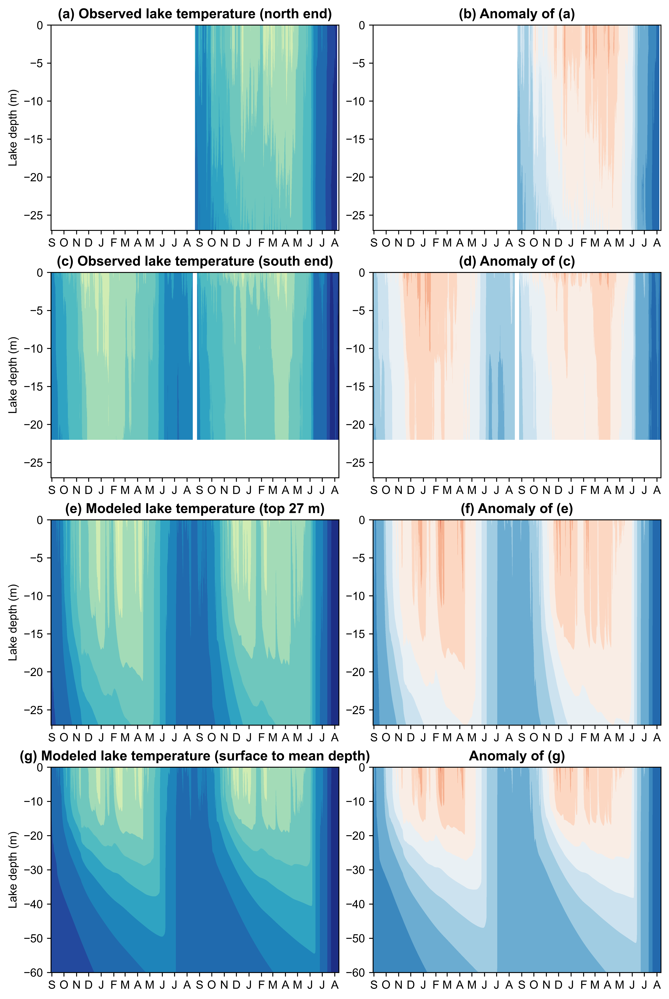

In [668]:
# Plot
fig = plt.figure(figsize=(8, 12), layout="constrained", dpi = 600)
plt.rcParams.update({'font.size': 10})
plt.rcParams["font.family"] = "Arial"
spec = fig.add_gridspec(4, 2) # 4 rows, 2 columns

#############################################
# Row 1
ax00 = fig.add_subplot(spec[0, 0]) # Observed north
ax01 = fig.add_subplot(spec[0, 1]) # Observed north (anomaly)

# Row 2
ax10 = fig.add_subplot(spec[1, 0]) # Observed south
ax11 = fig.add_subplot(spec[1, 1]) # Observed south (anomaly)

# Row 3
ax20 = fig.add_subplot(spec[2, 0]) # Modeled (top 27)
ax21 = fig.add_subplot(spec[2, 1]) # Modeled (top 27, anomaly)

# Row 4
ax30 = fig.add_subplot(spec[3, 0]) # Modeled (mean 61 m)
ax31 = fig.add_subplot(spec[3, 1]) # Modeled (mean 61 m, anomaly)

#############################################
#levels 
levels = [6,6.5,7,7.5,8,8.5,9,9.5,10,10.5,11,11.5,12,12.5,13] 
levels2 = [-3.5,-3,-2.5,-2,-1.5,-1,-0.5,0,0.5,1,1.5,2,2.5,3,3.5]

# panel (a)
ax00.set_title("(a) Observed lake temperature (north end)",fontweight='bold')
ax00.set_ylabel("Lake depth (m)")
x2 = pd.date_range(start = '2017-08-21', end = "2018-08-07")
y2 = [0, -3,-6,-9,-12,-15,-18,-21,-24,-27]
X2,Y2 = np.meshgrid(x2,y2)
ax00.contourf(X2,Y2,north.T,levels,cmap = custom,extend='both')
ax00.xaxis.set_major_locator(MonthLocator())
ax00.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax00.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax00.set_ylim(-27,0)
ax00.set_yticks([0,-5,-10,-15,-20,-25])


# panel (b)
ax01.set_title("(b) Anomaly of (a)", fontweight='bold')
ax01.contourf(X2,Y2, north.T - south.iloc[:,0].mean(),levels2,cmap = "RdBu_r",extend='both')
ax01.xaxis.set_major_locator(MonthLocator())
ax01.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax01.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax01.set_ylim(-27,0)
ax01.set_yticks([0,-5,-10,-15,-20,-25])


# panel (c)
ax10.set_title("(c) Observed lake temperature (south end)",fontweight='bold')
ax10.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = [0, -2,-5,-7,-10,-12,-15,-17,-19,-22]
X1,Y1 = np.meshgrid(x,y1)
ax10.contourf(X1,Y1,south.T,levels,cmap = custom,extend='both')
ax10.xaxis.set_major_locator(MonthLocator())
ax10.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax10.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax10.set_ylim(-27,0)
ax10.set_yticks([0,-5,-10,-15,-20,-25])

# panel (d)
ax11.set_title("(d) Anomaly of (c)",fontweight='bold')
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
ax11.contourf(X1,Y1,south.T - south.iloc[:,0].mean(),levels2,cmap = "RdBu_r",extend='both')
ax11.xaxis.set_major_locator(MonthLocator())
ax11.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax11.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax11.set_ylim(-27,0)
ax11.set_yticks([0,-5,-10,-15,-20,-25])

# panel (e)
ax20.set_title("(e) Modeled lake temperature (top 27 m)",fontweight='bold')
ax20.set_ylabel("Lake depth (m)")
x3 = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y3 = range(0,-28,-1)
X3, Y3 = np.meshgrid(x3,y3)
ax20.contourf(X3,Y3,model.iloc[:,3:31].T, levels,cmap = custom,extend='both')

ax20.xaxis.set_major_locator(MonthLocator())
ax20.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax20.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax20.set_ylim(-27,0)
ax20.set_yticks([0,-5,-10,-15,-20,-25])

# panel (f)
ax21.set_title("(f) Anomaly of (e)",fontweight='bold')
ax21.contourf(X3,Y3,model.iloc[:,3:31].T - south.iloc[:,0].mean(), levels2,cmap = "RdBu_r",extend='both')

ax21.xaxis.set_major_locator(MonthLocator())
ax21.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax21.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax21.set_ylim(-27,0)
ax21.set_yticks([0,-5,-10,-15,-20,-25])

# panel (g)
ax30.set_title("(g) Modeled lake temperature (surface to mean depth)",fontweight='bold')
ax30.set_ylabel("Lake depth (m)")
x4 = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y4 = range(0,-61,-1)
X4, Y4 = np.meshgrid(x4,y4)
ax30.contourf(X4,Y4,model.iloc[:,3:64].T, levels,cmap = custom,extend='both')
ax30.xaxis.set_major_locator(MonthLocator())
ax30.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax30.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax30.set_ylim(-60,0)
ax30.set_yticks([0,-10,-20,-30,-40,-50,-60])


# panel (h)
ax31.set_title("Anomaly of (g)",fontweight='bold')
ax31.contourf(X4,Y4,model.iloc[:,3:64].T- south.iloc[:,0].mean(), levels2,cmap = "RdBu_r",extend='both')
ax31.xaxis.set_major_locator(MonthLocator())
ax31.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax31.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax31.set_ylim(-60,0)
ax31.set_yticks([0,-10,-20,-30,-40,-50,-60])

###############################################
# COLOR BAR
#cs = ax10.contourf(X1,Y1,south.T,levels,cmap = custom,extend='both')
#fig.subplots_adjust(bottom=0.1)
#cbar_ax = fig.add_axes([0.1, 0.05, 0.8, 0.015,])
#fig.colorbar(cs, cax = cbar_ax, orientation='horizontal', label='Lake temperature (℃)' )

fig.savefig("Figure4_mixfact50_28_check_copy.jpg")

## Figure 5: Timeseries (2000 - 2023)

In [ ]:
# Import files
model_long = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2023\profile-38-mixfact50.txt", sep = "\s+", header = None,
                        skiprows = 31+29, engine = "python")
atm = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Final_inputs\met-input_ERA5_ceres_2000-2023_daily.csv",header = None, 
                  skiprows = 31+29, engine = "python")
atm

In [ ]:
# Create time axes
t4 = pd.date_range(start = '2000-03-01', end = "2023-12-31")
t5 = pd.date_range(start = '1981-01-01', end = "2023-12-31")
t6 = t4.to_julian_date()

In [ ]:
# Calculate weighted-mean (whole-lake) temperature using in-situ lake area for each depth.
area = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Observed-data\lakearea.csv") 
LT_mean = np.average(model_long.iloc[:,3:], weights = area.area[0:92],axis = 1)

In [ ]:
# Calculate running average
test = np.convolve(model_long.iloc[:,3], np.ones(365*2)/(365*2), mode="valid")
test2 = np.convolve(atm.iloc[:,3]-273.15, np.ones(365*2)/(365*2), mode="valid")
test3 = np.convolve(LT_mean,np.ones(365*2)/(365*2), mode="valid")


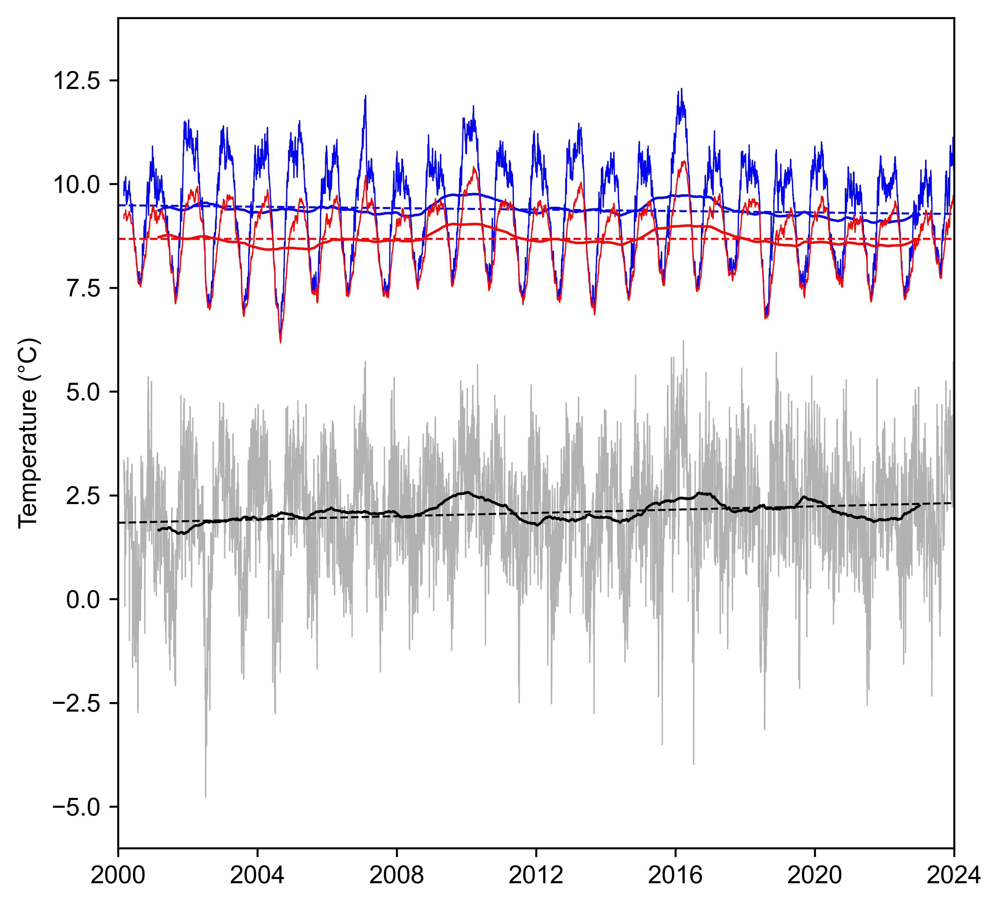

In [757]:
# Figure 4
fig, ax = plt.subplots(nrows = 1, figsize = (6,6), dpi = 600)

# (a) LST 
ax.plot(t4,model_long.iloc[:,3],linewidth = 0.5, color = "b")
ax.plot(t4[365:len(t4)-364],test,linewidth = 1, color = "b")
ax.plot([datetime.date(2000,1,1),datetime.date(2024,1,1)], [(((-0.008716)*2000)+26.91812),(((-0.008716)*2024)+26.91812)], "--", linewidth = 0.8, color = "b")
ax.set_xlim([datetime.date(2000, 1, 1), datetime.date(2024, 1, 1)])

# Whole-lake mean
ax.plot(t4,LT_mean,linewidth = 0.5, color = "r")
ax.plot(t4[365:len(t4)-364],test3,linewidth = 1, color = "r")
ax.plot([datetime.date(2000,1,1),datetime.date(2024,1,1)], [(((9.7919e-6)*2000)+8.6567),(((9.7919e-6)*2024)+8.6567)], "--", linewidth = 0.8, color = "r")

# Air temperature (qm ERA5-Land)
ax.plot(t4,atm.iloc[:,3]-273.15,linewidth = 0.5, color = "k",alpha = 0.3)
ax.plot([datetime.date(2000,1,1),datetime.date(2024,1,1)], [(((0.019798)*2000)-37.7591),(((0.019798)*2024)-37.7591)], "--", linewidth = 0.8, color = "k")
ax.plot(t4[365:len(t4)-364],test2,linewidth = 1, color = "k")
ax.set_ylim(-6,14)
ax.set_ylabel("Temperature (\u00B0C)")

#fig.savefig("Figure5.jpg")

## Figure 6: 2000 - 2100 temperatures and lake evaporation

In [ ]:
# Import files
hist_LT = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2023\profile-38-mixfact50.txt", sep = "\s+", header = None,
                        skiprows = 31+29, engine = "python")
hist_LT_mean = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2023\LST_mean.csv")

hist_AT = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Final_inputs\met-input_ERA5_ceres_2000-2023_daily.csv",header = None, 
                  skiprows = 31+29, engine = "python")
hist_EV = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2023\surface-38-mixfact50.txt", sep = ",", header = None,
                        skiprows = 31+29, engine = "python")
ssp245_10_10_LT = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\results\profile-38-ssp245_10_10.txt", sep = "\s+", header = None,
                         engine = "python") #for testing

# time axes
t_hist = pd.date_range(start = '2000-03-01', end = "2023-12-31")


In [ ]:
# Time axes for SSP series (365 days x 85 years)
t_ssp = pd.date_range(start = '2015-01-01', end = "2100-12-31")
t_ssp = t_ssp[~((t_ssp.month == 2) & (t_ssp.day == 29))]

In [ ]:
# Time axes
t_ssp3 = pd.date_range(start='2015-01-01',periods=86,freq='AS')
t_hist2 = pd.date_range(start='2000-01-01',periods=24,freq='AS')

In [ ]:
t_ssp2 = pd.DataFrame(t_ssp)
t_ssp2.columns = ["Date"]
t_ssp2["Year"] = t_ssp2['Date'].dt.year
t_ssp2["Month"] = t_ssp2['Date'].dt.month
t_ssp2["Day"] = t_ssp2['Date'].dt.day
t_ssp2

In [ ]:
# weighted mean
area = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Observed-data\lakearea.csv")
#for i in range(0,len(model_long)):    
LST_mean = np.average(ssp245_10_10_LT.iloc[:,3:], weights = area.area[0:92],axis = 1)

In [ ]:
# Calculate ensemble means for lake temperatures (surface = LST, whole-lake = LT)
import os
import glob

path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\results"
all_files = glob.glob(os.path.join(path,'profile-38-ssp245_*.txt'))
LST_ssp245 = pd.DataFrame()
LT_ssp245 = pd.DataFrame()
LST_ssp585 = pd.DataFrame()
LT_ssp585 = pd.DataFrame()

#ssp245
test = (pd.read_csv(f, header = None, sep = "\s+", usecols = [3], engine = "python") for f in all_files)
LST_ssp245 = pd.concat(test, axis = 1, ignore_index = True)

for i in range(0,len(all_files)):
    test = pd.read_csv(all_files[i], header = None, sep = "\s+", usecols = range(3,95),engine = "python")
    test_mean = pd.DataFrame(np.average(test, weights = area.area[0:92],axis = 1))
    LT_ssp245 = pd.concat([LT_ssp245,test_mean], axis = 1, ignore_index = True)

path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\results"
all_files = glob.glob(os.path.join(path,"profile-38-ssp585_*.txt"))

#ssp585
test = (pd.read_csv(f, header = None, sep = "\s+", usecols = [3], engine = "python") for f in all_files)
LST_ssp585 = pd.concat(test, axis = 1, ignore_index = True)

for i in range(0,len(all_files)):
    test = pd.read_csv(all_files[i], header = None, sep = "\s+", usecols = range(3,95),engine = "python")
    test_mean = pd.DataFrame(np.average(test, weights = area.area[0:92],axis = 1))
    LT_ssp585 = pd.concat([LT_ssp585,test_mean], axis = 1, ignore_index = True)

In [22]:
# Export
LST_ssp245.to_csv("LST_ssp245.csv")
LT_ssp245.to_csv("LT_ssp245.csv")
LST_ssp585.to_csv("LST_ssp585.csv")
LT_ssp585.to_csv("LT_ssp585.csv")

In [ ]:
# Add time axes
LT_list = [LST_ssp245, LT_ssp245, LST_ssp585, LT_ssp585]
for i in range(0,4):
    LT_list[i]["Date"] = t_ssp2["Date"]
    LT_list[i]["Year"] = t_ssp2["Year"]
    LT_list[i]["Month"] = t_ssp2["Month"]
    LT_list[i]["Day"] = t_ssp2["Day"]

In [ ]:
# Calculate LT ERA5-land
hist_LT_mean = np.average(hist_LT.groupby([0], as_index = False).mean().iloc[0:16,3:], weights = area.area[0:92], axis = 1)

In [ ]:
#air temp SSP2-4.5 and SSP5-8.5
path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\final_inputs"
all_files = glob.glob(os.path.join(path,"ssp245_*.txt"))
AT_ssp245 = pd.DataFrame()
AT_ssp585 = pd.DataFrame()
for i in range(0,len(all_files)):
    test = pd.read_csv(all_files[i], header = None, sep = '\s+', engine = "python")
    test = test.groupby([0], as_index = False).mean()
    AT_ssp245 = pd.concat([AT_ssp245, test.iloc[:,4]], axis = 1, ignore_index = True)
AT_ssp245 = AT_ssp245 - 273.15

path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\final_inputs"
all_files = glob.glob(os.path.join(path,"ssp585_*.txt"))
for i in range(0,len(all_files)):
    test = pd.read_csv(all_files[i], header = None, sep = '\s+', engine = "python")
    test = test.groupby([0], as_index = False).mean()
    AT_ssp585 = pd.concat([AT_ssp585, test.iloc[:,4]], axis = 1, ignore_index = True)
AT_ssp585 = AT_ssp585 - 273.15

AT_ssp245.to_csv("AT_ssp245.csv")
AT_ssp585.to_csv("AT_ssp585.csv")

In [ ]:
# Calculate lake evaporation 
import os
import glob
# evaporation
path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\results"
all_files = glob.glob(os.path.join(path,'surface-38-ssp245_*.txt'))
EV_ssp245 = pd.DataFrame()
EV_ssp585 = pd.DataFrame()

#ssp245
test = (pd.read_csv(f, header = None, sep = ",", usecols = [8], engine = "python") for f in all_files)
EV_ssp245 = pd.concat(test, axis = 1, ignore_index = True)


path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\results"
all_files = glob.glob(os.path.join(path,"surface-38-ssp585_*.txt"))

#ssp585
test = (pd.read_csv(f, header = None, sep = ",", usecols = [8], engine = "python") for f in all_files)
EV_ssp585 = pd.concat(test, axis = 1, ignore_index = True)



In [ ]:
# Add time axes
EV_list = [EV_ssp245, EV_ssp585]
for i in range(0,2):
   # EV_list[i]["Date"] = t_ssp2["Date"]
    EV_list[i]["Year"] = t_ssp2["Year"]
    EV_list[i]["Month"] = t_ssp2["Month"]
    EV_list[i]["Day"] = t_ssp2["Day"]
    

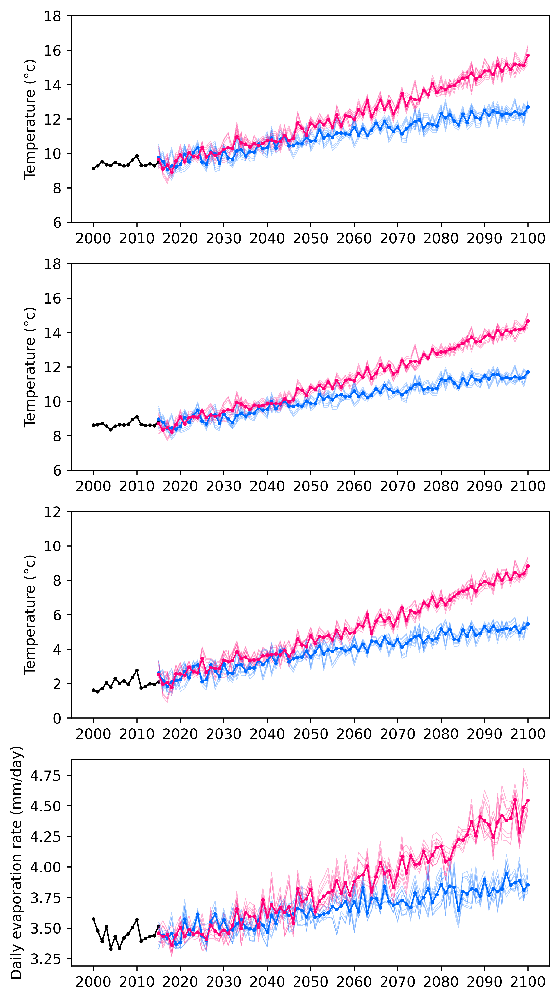

In [130]:
# Plot
fig, ax = plt.subplots(nrows = 4, figsize = (6,12), dpi = 600)

# (a) Lake temperature surface
ax[0].plot(t_hist2[0:16], hist_LT.groupby([0], as_index = False).mean().iloc[0:16,3], ".-", linewidth = 1, color = "k", markersize = 3)
for i in range(0,9):
    ax[0].plot(t_ssp3, LST_ssp245.groupby(["Year"]).mean().iloc[:,i], "-", linewidth = 0.5, color = "#006aff", alpha = 0.3)
    ax[0].plot(t_ssp3, LST_ssp585.groupby(["Year"]).mean().iloc[:,i], "-", linewidth = 0.5, color = "#ff0077", alpha = 0.3)
ax[0].plot(t_ssp3, LST_ssp245.groupby(["Year"]).mean().iloc[:,0:9].mean(axis = 1), ".-", linewidth = 1, color = "#006aff", markersize = 3)
ax[0].plot(t_ssp3, LST_ssp585.groupby(["Year"]).mean().iloc[:,0:9].mean(axis = 1), ".-", linewidth = 1, color = "#ff0077", markersize = 3)
ax[0].set_ylim(6,18)
ax[0].set_ylabel("Temperature (\u00b0c)")
#ax[0].set_xlim(2000,2100)
ax[0].xaxis.set_major_locator(mdates.YearLocator(base=10))   
ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y'))


# (b) Lake temperature whole
ax[1].plot(t_hist2[0:16], hist_LT_mean, ".-", linewidth = 1, color = "k", markersize = 3)
for i in range(0,9):
    ax[1].plot(t_ssp3, LT_ssp245.groupby(["Year"]).mean().iloc[:,i], "-", linewidth = 0.5, color = "#006aff", alpha = 0.3)
    ax[1].plot(t_ssp3, LT_ssp585.groupby(["Year"]).mean().iloc[:,i], "-", linewidth = 0.5, color = "#ff0077", alpha = 0.3)
ax[1].plot(t_ssp3, LT_ssp245.groupby(["Year"]).mean().iloc[:,0:9].mean(axis = 1), ".-", linewidth = 1, color = "#006aff", markersize = 3)
ax[1].plot(t_ssp3, LT_ssp585.groupby(["Year"]).mean().iloc[:,0:9].mean(axis = 1), ".-", linewidth = 1, color = "#ff0077", markersize = 3)
ax[1].set_ylim(6,18)
ax[1].set_ylabel("Temperature (\u00b0c)")
ax[1].xaxis.set_major_locator(mdates.YearLocator(base=10)) 
#ax[1].set_xlim(2000,2100)

# (c) Air temperature
ax[2].plot(t_hist2[0:16], hist_AT.groupby([0], as_index = False).mean().iloc[0:16,3] - 273.15, ".-", linewidth = 1, color = "k", markersize = 3)

for i in range(0,9):
    ax[2].plot(t_ssp3, AT_ssp245[i], "-", linewidth = 0.5, color = "#006aff", alpha = 0.3)
    ax[2].plot(t_ssp3, AT_ssp585[i], "-", linewidth = 0.5, color = "#ff0077", alpha = 0.3)
ax[2].plot(t_ssp3, AT_ssp245.mean(axis = 1), ".-", linewidth = 1, color = "#006aff", markersize = 3)
ax[2].plot(t_ssp3, AT_ssp585.mean(axis = 1), ".-", linewidth = 1, color = "#ff0077", markersize = 3)
ax[2].set_ylabel("Temperature (\u00b0c)")
ax[2].set_ylim(0,12)
ax[2].xaxis.set_major_locator(mdates.YearLocator(base=10)) 


# (d) Lake evaporation
ax[3].plot(t_hist2[0:16], hist_EV.groupby([0], as_index = False).mean().iloc[0:16,8], ".-", linewidth = 1, color = "k", markersize = 3)
for i in range(0,9):
    ax[3].plot(t_ssp3, EV_ssp245.groupby(["Year"]).mean().iloc[:,i], "-", linewidth = 0.5, color = "#006aff", alpha = 0.3)
    ax[3].plot(t_ssp3, EV_ssp585.groupby(["Year"]).mean().iloc[:,i], "-", linewidth = 0.5, color = "#ff0077", alpha = 0.3)
ax[3].plot(t_ssp3, EV_ssp245.groupby(["Year"]).mean().iloc[:,0:9].mean(axis = 1), ".-", linewidth = 1, color = "#006aff", markersize = 3)
ax[3].plot(t_ssp3, EV_ssp585.groupby(["Year"]).mean().iloc[:,0:9].mean(axis = 1), ".-", linewidth = 1, color = "#ff0077", markersize = 3)
#ax[3].set_ylim(6,18)
ax[3].set_ylabel("Daily evaporation rate (mm/day)")
ax[3].xaxis.set_major_locator(mdates.YearLocator(base=10))   
ax[3].xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
#fig.savefig("Figure6.jpg")

## Figure 7: lake temperature differences

In [ ]:
# Calculate mean lake temperature ensemble
path = r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Series-2000-2100\results"
all_files = glob.glob(os.path.join(path,'profile-38-ssp585_*.txt'))
meanL_ssp245 = pd.DataFrame()
meanL_ssp585 = pd.DataFrame()

#ssp585
for j in range(0,92): #lake depth
    print(j)
    test = (pd.read_csv(f, header = None, sep = "\s+", usecols = [j+3], engine = "python") for f in all_files)
    test2 = pd.concat(test, axis = 1, ignore_index = True).mean(axis = 1)
    meanL_ssp585 = pd.concat([meanL_ssp585,test2], axis = 1, ignore_index = True)


In [ ]:
# Add time axes
mean_list = [meanL_ssp245, meanL_ssp585]
for i in range(0,2):
    mean_list[i]["Year"] = t_ssp2["Year"]
    mean_list[i]["Month"] = t_ssp2["Month"]
    mean_list[i]["Day"] = t_ssp2["Day"]

In [ ]:
# Calculate decadal means
meanL_ssp245_15 = meanL_ssp245[meanL_ssp245.Year <2025].groupby(["Month","Day"], as_index = False).mean()
meanL_ssp245_91 = meanL_ssp245[meanL_ssp245.Year >2090].groupby(["Month","Day"], as_index = False).mean()

meanL_ssp585_15 = meanL_ssp585[meanL_ssp585.Year <2025].groupby(["Month","Day"], as_index = False).mean()
meanL_ssp585_91 = meanL_ssp585[meanL_ssp585.Year >2090].groupby(["Month","Day"], as_index = False).mean()


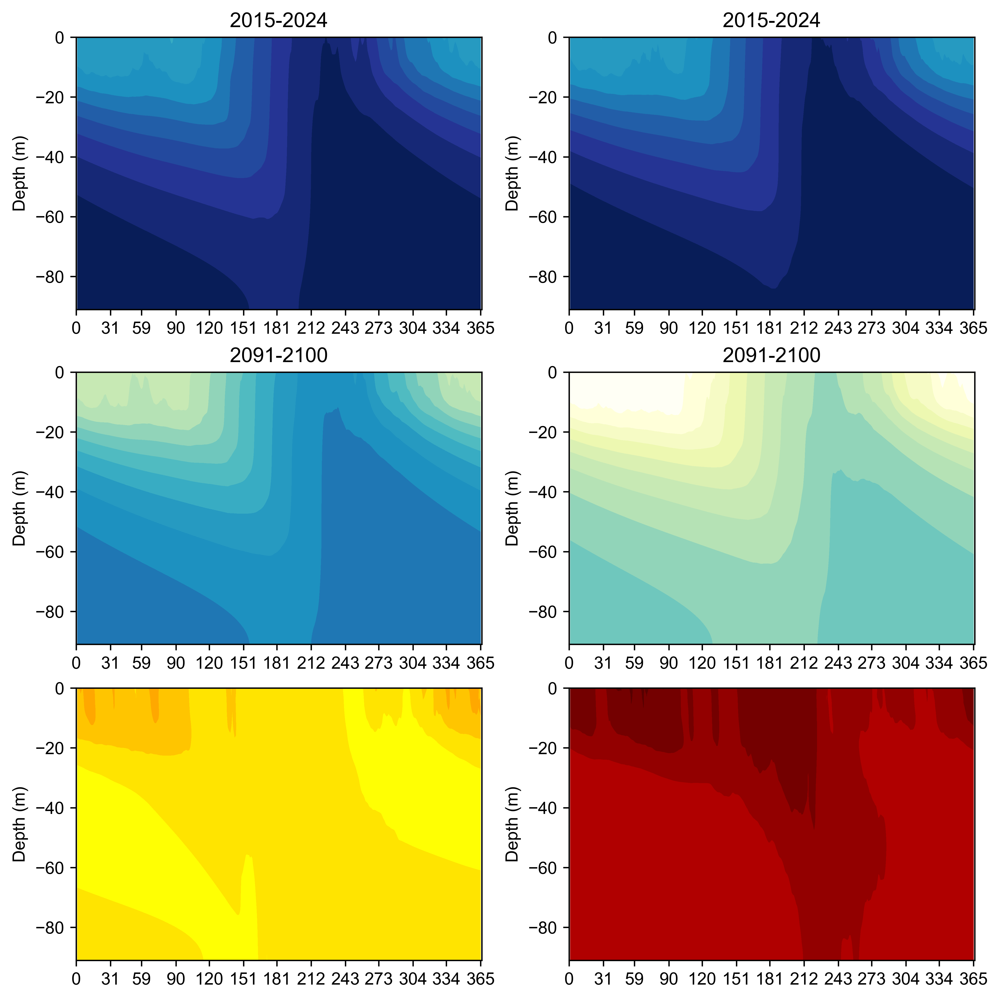

In [196]:
# plot
fig = plt.figure(figsize=(8, 8), layout="constrained", dpi = 600)
plt.rcParams.update({'font.size': 10})
plt.rcParams["font.family"] = "Arial"
spec = fig.add_gridspec(3, 2) # 4 rows, 2 columns

#############################################
# Row 1
ax00 = fig.add_subplot(spec[0, 0]) # 2015-2024 (SSP2-4.5)
ax01 = fig.add_subplot(spec[0, 1]) # 2015-2024 (SSP5-8.5)

# Row 2
ax10 = fig.add_subplot(spec[1, 0]) # 2091-2100
ax11 = fig.add_subplot(spec[1, 1]) # 

# Row 3
ax20 = fig.add_subplot(spec[2, 0]) # Difference between the two 
ax21 = fig.add_subplot(spec[2, 1]) # 



#############################################
levels = [7,7.5,8,8.5,9,9.5,10,10.5,11,11.5,12,12.5,13,13.5,14,14.5,15,15.5,16,17]
levels2 = [1,1.25,1.5,1.75,2,2.25,2.5,2.75,3,3.25,3.5,3.75,4,4.25,4.5,4.75,5,5.25,5.5,5.75,6,6.25,6.5] 
ticks = [0,31, 59,90,120,151,181,212,243,273,304,334,365]
#ticks_L = ["J","F","M","A","M","J","J","A","S","O","N","D"]

# panel (a)
ax00.set_title("2015-2024")
ax00.set_ylabel("Depth (m)")
x = range(1,366)
y = range(0,-92,-1)
X,Y = np.meshgrid(x,y)
ax00.contourf(X,Y, meanL_ssp245_15.iloc[:,2:94].T, levels, cmap = custom,extend='both')
ax00.set_xticks(ticks)
ax00.set_xlim(0,366)
#ax00.set_xlabel(ticks_L)

# panel (b)
ax01.set_title("2015-2024")
ax01.set_ylabel("Depth (m)")
ax01.contourf(X,Y, meanL_ssp585_15.iloc[:, 2:94].T, levels, cmap = custom,extend='both')
ax01.set_xticks(ticks)
ax01.set_xlim(0,366)
#ax01.set_xlabel(ticks_L)

# panel (c)
ax10.set_title("2091-2100")
ax10.set_ylabel("Depth (m)")
ax10.contourf(X,Y, meanL_ssp245_91.iloc[:, 2:94].T, levels, cmap = custom,extend='both')
ax10.set_xticks(ticks)
ax10.set_xlim(0,366)
#ax10.set_xlabel(ticks_L)


# panel (d)
ax11.set_title("2091-2100")
ax11.set_ylabel("Depth (m)")
ax11.contourf(X,Y, meanL_ssp585_91.iloc[:, 2:94].T, levels, cmap = custom,extend='both')
ax11.set_xticks(ticks)
ax11.set_xlim(0,366)
#ax11.set_xlabel(ticks_L)

# panel (e)
ax20.set_ylabel("Depth (m)")
ax20.contourf(X,Y, meanL_ssp245_91.iloc[:, 2:94].T - meanL_ssp245_15.iloc[:,2:94].T, levels2, cmap = "hot_r",extend='both')
ax20.set_xticks(ticks)
ax20.set_xlim(0,366)
#ax20.set_xlabel(ticks_L)

# panel (f)
ax21.set_ylabel("Depth (m)")
ax21.contourf(X,Y, meanL_ssp585_91.iloc[:, 2:94].T - meanL_ssp585_15.iloc[:,2:94].T, levels2, cmap = "hot_r",extend='both')
ax21.set_xticks(ticks)
ax21.set_xlim(0,366)
#ax21.set_xlabel(ticks_L)

###############################################
fig.savefig("Figure7.jpg")

In [ ]:
# COLOR BAR
fig = plt.figure(figsize=(4, 8), layout="constrained", dpi = 600)
cs = ax11.contourf(X,Y, meanL_ssp585_91.iloc[:, 2:94].T, levels, cmap = custom,extend='both')
cbar_ax = fig.add_axes([0.1, 0.05, 0.8, 0.015,])
fig.colorbar(cs, cax = cbar_ax, orientation='horizontal', label='Lake temperature (\u00B0C)' )
fig.savefig("colorbar2.jpg")

## Supplementary figure: MIXFACT effect

In [ ]:
fig = plt.figure(figsize=(8, 8), layout="constrained", dpi = 600)
plt.rcParams.update({'font.size': 10})
plt.rcParams["font.family"] = "Arial"
spec = fig.add_gridspec(4, 2) # 4 rows, 2 columns

#############################################
# Row 1
ax00 = fig.add_subplot(spec[0, 0]) # MIXFACT = 1
ax01 = fig.add_subplot(spec[0, 1]) # MIXFACT = 5

# Row 2
ax10 = fig.add_subplot(spec[1, 0]) # MIXFACT = 10
ax11 = fig.add_subplot(spec[1, 1]) # MIXFACT = 50

# Row 3
ax20 = fig.add_subplot(spec[2, 0]) # MIXFACT = 100
ax21 = fig.add_subplot(spec[2, 1]) # MIXFACT = 250

# Row 4
ax30 = fig.add_subplot(spec[3, 0]) # MIXFACT = 500 
ax31 = fig.add_subplot(spec[3, 1]) # MIXFACT = 1000

levels = [6,6.5,7,7.5,8,8.5,9,9.5,10,10.5,11,11.5,12,12.5,13] 

model1 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact1\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")
model2 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact5\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")
model3 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact10\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")
model4 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact50\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")
model5 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact100\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")
model6 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact250\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")
model7 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact500\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")
model8 = pd.read_csv(r"C:\Users\nadia\PhD\lakemodeling\Updated_analysis\Calibration\mixfact1000\profile-38.txt", sep = "\s+", header = None,
                   skiprows = 241, skipfooter = 365-222, engine = "python")

ax00.set_title("MIXFACT = 1",fontweight='bold')
ax00.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax00.contourf(X1,Y1,model1.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax00.xaxis.set_major_locator(MonthLocator())
ax00.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax00.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax00.set_ylim(-92,0)
ax00.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])


ax01.set_title("MIXFACT = 5",fontweight='bold')
ax01.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax01.contourf(X1,Y1,model2.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax01.xaxis.set_major_locator(MonthLocator())
ax01.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax01.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax01.set_ylim(-92,0)
ax01.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])

ax10.set_title("MIXFACT = 10",fontweight='bold')
ax10.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax10.contourf(X1,Y1,model3.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax10.xaxis.set_major_locator(MonthLocator())
ax10.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax10.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax10.set_ylim(-92,0)
ax10.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])

ax11.set_title("MIXFACT = 50",fontweight='bold')
ax11.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax11.contourf(X1,Y1,model4.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax11.xaxis.set_major_locator(MonthLocator())
ax11.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax11.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax11.set_ylim(-92,0)
ax11.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])

ax20.set_title("MIXFACT = 100",fontweight='bold')
ax20.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax20.contourf(X1,Y1,model5.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax20.xaxis.set_major_locator(MonthLocator())
ax20.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax20.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax20.set_ylim(-92,0)
ax20.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])


ax21.set_title("MIXFACT = 250",fontweight='bold')
ax21.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax21.contourf(X1,Y1,model6.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax21.xaxis.set_major_locator(MonthLocator())
ax21.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax21.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax21.set_ylim(-92,0)
ax21.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])

ax30.set_title("MIXFACT = 500",fontweight='bold')
ax30.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax30.contourf(X1,Y1,model7.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax30.xaxis.set_major_locator(MonthLocator())
ax30.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax30.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax30.set_ylim(-92,0)
ax30.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])

ax31.set_title("MIXFACT = 1000",fontweight='bold')
ax31.set_ylabel("Lake depth (m)")
x = np.arange(np.datetime64('2016-08-30'), np.datetime64('2018-08-12'))
y1 = range(0,-92,-1)
X1,Y1 = np.meshgrid(x,y1)
ax31.contourf(X1,Y1,model8.iloc[:,3:].T,levels,cmap = custom,extend='both')
ax31.xaxis.set_major_locator(MonthLocator())
ax31.xaxis.set_major_formatter(FuncFormatter(m_fmt))
ax31.set_xlim([datetime.date(2016, 8, 30), datetime.date(2018, 8, 11)])
ax31.set_ylim(-92,0)
ax31.set_yticks([0,-10,-20,-30,-40,-50,-60,-70,-80,-90])

fig.savefig("MIXFACT-effect.jpg")